<a href="https://colab.research.google.com/github/zizizw/Business-Analytics-Projects/blob/main/Customer%20Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import datetime
import matplotlib.pyplot as plt
import warnings
import statsmodels.api as sm
import seaborn as sns
from sklearn import tree
from sklearn.cluster import AgglomerativeClustering,KMeans
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import silhouette_score, silhouette_samples, accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.multioutput import MultiOutputClassifier
from sklearn.preprocessing import LabelEncoder, StandardScaler
from matplotlib import colors
from matplotlib.colors import ListedColormap
warnings.filterwarnings("ignore")

# Import Data & Preprocessing

In [ ]:
#import dataset
data_df = pd.read_csv('marketing_campaign.csv',sep='\t')
df = data_df.copy()
df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,13-06-2013,46,709,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,PhD,Together,64014.0,2,1,10-06-2014,56,406,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,25-01-2014,91,908,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,Master,Together,69245.0,0,1,24-01-2014,8,428,...,3,0,0,0,0,0,0,3,11,0


In [ ]:
#data processing - null data
print(df.isnull().sum())

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64


In [ ]:
df.dropna(inplace=True)
print(df.isnull().sum())

ID                     0
Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Z_CostContact          0
Z_Revenue              0
Response               0
dtype: int64


In [ ]:
df.describe()

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
count,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,...,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.0,2216.0,2216.000000
mean,5588.353339,1968.820397,52247.251354,0.441787,0.505415,49.012635,305.091606,26.356047,166.995939,37.637635,...,5.319043,0.073556,0.074007,0.073105,0.064079,0.013538,0.009477,3.0,11.0,0.150271
std,3249.376275,11.985554,25173.076661,0.536896,0.544181,28.948352,337.327920,39.793917,224.283273,54.752082,...,2.425359,0.261106,0.261842,0.260367,0.244950,0.115588,0.096907,0.0,0.0,0.357417
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
25%,2814.750000,1959.000000,35303.000000,0.000000,0.000000,24.000000,24.000000,2.000000,16.000000,3.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,174.500000,8.000000,68.000000,12.000000,...,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
75%,8421.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,505.000000,33.000000,232.250000,50.000000,...,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,...,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.0,11.0,1.000000


Feature Engineering

In [ ]:
df['children']=df['Teenhome']+df['Kidhome']
df['age']=2014-df['Year_Birth']

Drop Outliers

In [ ]:
df.drop(df.loc[df['Marital_Status']=='Absurd'].index, inplace = True)
df.drop(df.loc[df['Marital_Status']=='Alone'].index, inplace = True)
df.drop(df.loc[df['Marital_Status']=='YOLO'].index, inplace = True)
df.drop(df.loc[df["Income"] >= 600000].index, inplace = True)
df.drop(df.loc[df["age"] >= 100].index, inplace = True)
df.describe()

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,children,age
count,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,...,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.0,2205.0,2205.000000,2205.000000,2205.000000
mean,5588.418594,1968.898866,51954.615420,0.441723,0.505669,49.082993,305.390930,26.328345,167.195465,37.567800,...,0.074376,0.072562,0.063946,0.013605,0.009070,3.0,11.0,0.149660,0.947392,45.101134
std,3244.026348,11.695828,21544.431675,0.537083,0.544390,28.942914,337.684201,39.750140,224.407992,54.603575,...,0.262442,0.259476,0.244711,0.115872,0.094827,0.0,0.0,0.356819,0.749439,11.695828
min,0.000000,1940.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000,0.000000,18.000000
25%,2826.000000,1959.000000,35196.000000,0.000000,0.000000,24.000000,24.000000,2.000000,16.000000,3.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000,0.000000,37.000000
50%,5455.000000,1970.000000,51373.000000,0.000000,0.000000,49.000000,174.000000,8.000000,68.000000,12.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000,1.000000,44.000000
75%,8420.000000,1977.000000,68487.000000,1.000000,1.000000,74.000000,505.000000,33.000000,233.000000,50.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000,1.000000,55.000000
max,11191.000000,1996.000000,162397.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,3.0,11.0,1.000000,3.000000,74.000000


Change the categorical features Marriage Status and Education into numerical values.

In [ ]:
#turn categorical data to dummies
categorical_features = ["Education", "Marital_Status"]
categorical_df = df[categorical_features]
dummy_df = pd.get_dummies(categorical_df,drop_first = True)
concat_df = pd.concat([df, dummy_df],axis = 1)
concat_df.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response',
       'children', 'age', 'Education_Basic', 'Education_Graduation',
       'Education_Master', 'Education_PhD', 'Marital_Status_Married',
       'Marital_Status_Single', 'Marital_Status_Together',
       'Marital_Status_Widow'],
      dtype='object')

# Object 1: Current Customer Clustering

In [ ]:
selected_features = ['age','Income','children','Education_Basic', 'Education_Graduation', 'Education_Master',
       'Education_PhD', 'Marital_Status_Married', 'Marital_Status_Single',
       'Marital_Status_Together', 'Marital_Status_Widow']
data_selected = concat_df[selected_features]

scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_selected)
pca = PCA(n_components=7)
principal_components = pca.fit_transform(data_scaled)

for n in range(2, 12):
  pca = PCA(n_components=n)
  pca_result = pca.fit_transform(data_scaled)
  explained_variance = pca.explained_variance_ratio_
  cumulative_variance = explained_variance.cumsum()
  print(n, ":", cumulative_variance)

pca_df = pd.DataFrame(data=principal_components, columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7'])
pca_df

2 : [0.15169164 0.28877636]
3 : [0.15169164 0.28877636 0.42280696]
4 : [0.15169164 0.28877636 0.42280696 0.54666061]
5 : [0.15169164 0.28877636 0.42280696 0.54666061 0.65805774]
6 : [0.15169164 0.28877636 0.42280696 0.54666061 0.65805774 0.76145723]
7 : [0.15169164 0.28877636 0.42280696 0.54666061 0.65805774 0.76145723
 0.85560806]
8 : [0.15169164 0.28877636 0.42280696 0.54666061 0.65805774 0.76145723
 0.85560806 0.92785227]
9 : [0.15169164 0.28877636 0.42280696 0.54666061 0.65805774 0.76145723
 0.85560806 0.92785227 0.97415693]
10 : [0.15169164 0.28877636 0.42280696 0.54666061 0.65805774 0.76145723
 0.85560806 0.92785227 0.97415693 0.98760839]
11 : [0.15169164 0.28877636 0.42280696 0.54666061 0.65805774 0.76145723
 0.85560806 0.92785227 0.97415693 0.98760839 1.        ]


,PC1,PC2,PC3,PC4,PC5,PC6,PC7
0,-1.012620,-1.296985,-0.693853,1.753058,0.080019,0.686982,-0.107823
1,-1.025480,-0.815069,0.327776,0.457327,-0.759138,2.039782,-0.981064
2,-0.468203,-1.974845,-1.172620,-0.641700,0.353967,-1.240406,0.354855
3,-1.518487,-1.090723,0.775708,-1.388762,-0.290675,-0.893368,-0.091129
4,1.210612,1.737869,-0.142861,0.618628,-0.955295,-1.094889,-0.472878
...,...,...,...,...,...,...,...
2200,-0.837537,1.041395,-1.336361,-0.365689,0.093340,0.050054,-0.034782
2201,2.564137,-1.039325,0.591725,-1.928311,-2.011312,0.415513,-1.295281
2202,-1.313655,-0.436999,-0.759104,0.573241,0.294767,-0.722751,0.372848
2203,1.831290,-1.517918,0.480871,-1.216182,2.092731,0.029299,-0.087196


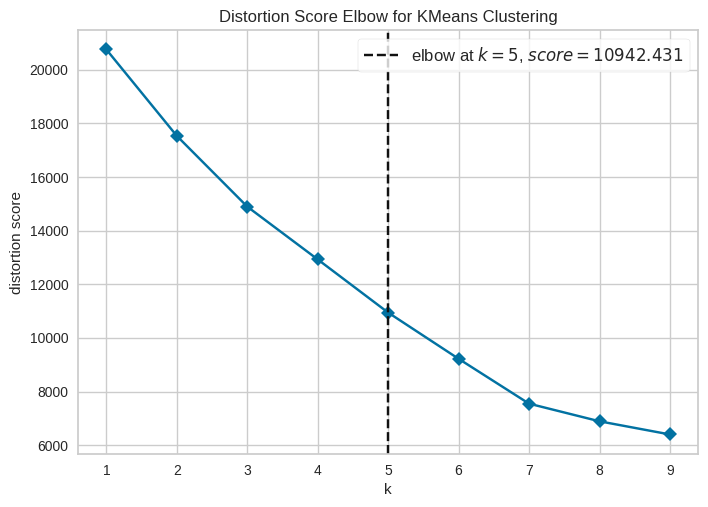

KElbowVisualizer(ax=<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>,
                 estimator=KMeans(n_clusters=9, random_state=18), k=(1, 10),
                 timings=False)

In [ ]:
from yellowbrick.cluster.elbow import kelbow_visualizer
kelbow_visualizer(KMeans(random_state=18),
                  pca_df,
                  k=(1, 10),
                  timings=False)

Therefore we choose k=5 in clustering.

In [ ]:
kmeans = KMeans(n_clusters=5, random_state=42)
cluster_labels = kmeans.fit_predict(principal_components)

pca_df = pd.DataFrame(principal_components, columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7'])
pca_df['Cluster'] = cluster_labels
concat_df['Cluster_Customer'] = cluster_labels
df['Cluster_Customer'] = cluster_labels

'''
#cluster visualization
plt.figure(figsize=(8, 6))
plt.scatter(pca_df['PC1'], pca_df['PC2'], c=pca_df['Cluster'], cmap='viridis')
plt.title('Cluster Visualization')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar()
plt.show()
'''

"\n#cluster visualization\nplt.figure(figsize=(8, 6))\nplt.scatter(pca_df['PC1'], pca_df['PC2'], c=pca_df['Cluster'], cmap='viridis')\nplt.title('Cluster Visualization')\nplt.xlabel('Principal Component 1')\nplt.ylabel('Principal Component 2')\nplt.colorbar()\nplt.show()\n"

In [ ]:
cluster0 = df[df['Cluster_Customer'] == 0]
cluster1 = df[df['Cluster_Customer'] == 1]
cluster2 = df[df['Cluster_Customer'] == 2]
cluster3 = df[df['Cluster_Customer'] == 3]
cluster4 = df[df['Cluster_Customer'] == 4]

selected_columns = ["age", "Education", "Marital_Status", "Income", "children"]
cluster0[selected_columns]

,age,Education,Marital_Status,Income,children
0,57,Graduation,Single,58138.0,0
1,60,Graduation,Single,46344.0,2
15,68,PhD,Single,82800.0,0
19,29,2n Cycle,Single,33812.0,1
25,45,Graduation,Single,18589.0,0
...,...,...,...,...,...
2224,44,PhD,Single,57642.0,1
2227,52,Graduation,Single,57967.0,1
2230,30,Graduation,Single,11012.0,1
2231,44,Master,Single,44802.0,0


In [ ]:
writer = pd.ExcelWriter('clustering data.xlsx')
selected_features = ['age','Income','children','Education','Marital_Status','Recency',
                     'Complain', 'NumDealsPurchases', 'NumWebVisitsMonth']
cluster0[selected_features].to_excel(writer,'cluster0')
cluster1[selected_features].to_excel(writer,'cluster1')
cluster2[selected_features].to_excel(writer,'cluster2')
cluster3[selected_features].to_excel(writer,'cluster3')
cluster4[selected_features].to_excel(writer,'cluster4')
writer.save()

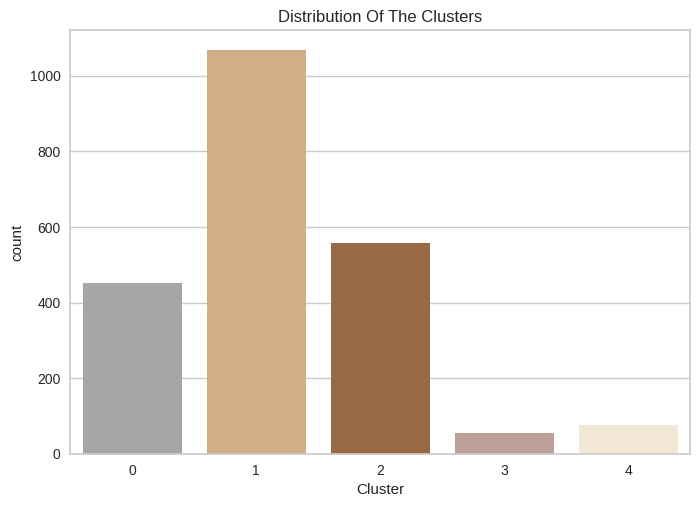

In [ ]:
pal = ["#a6a6a6", "#dcb07b", "#A66735", "#c59a94", "#F7ead0", "#FFDAB9"]
pl = sns.countplot(x=pca_df["Cluster"], palette= pal)
pl.set_title("Distribution Of The Clusters")
plt.show()

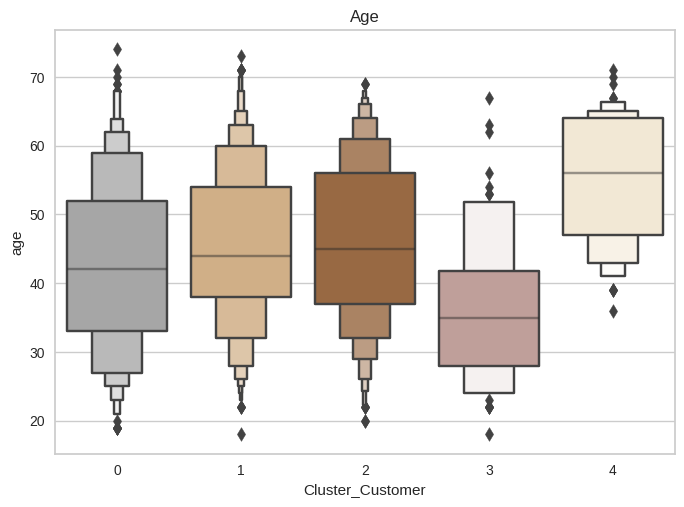

In [ ]:
#Plotting the age
plt.figure()
pl=sns.boxenplot(y=concat_df["age"],x=concat_df['Cluster_Customer'], palette= pal)
pl.set_title("Age")
plt.show()

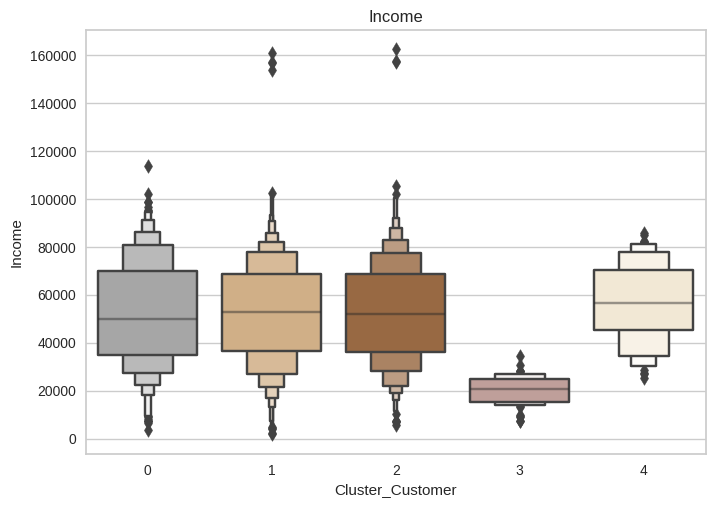

In [ ]:
#Plotting the income
plt.figure()
pl=sns.boxenplot(y=concat_df["Income"],x=concat_df['Cluster_Customer'], palette= pal)
pl.set_title("Income")
plt.show()

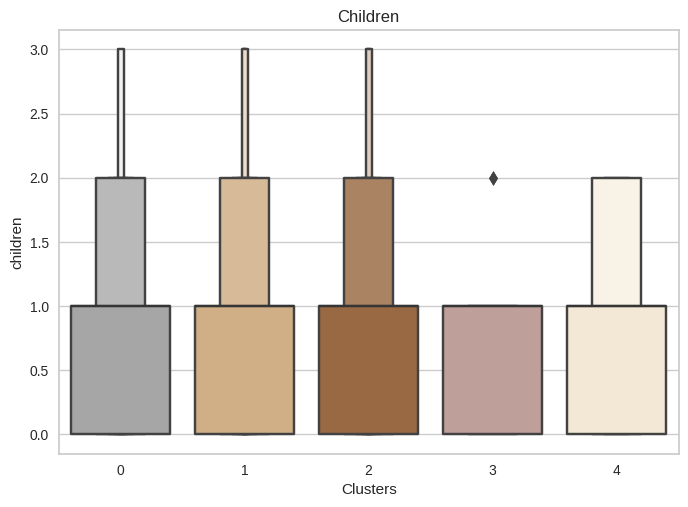

In [ ]:
#Plotting the children
plt.figure()
pl=sns.boxenplot(y=concat_df["children"],x=concat_df['Cluster_Customer'], palette= pal)
pl.set_title("Children")
pl.set_xlabel("Clusters")
plt.show()

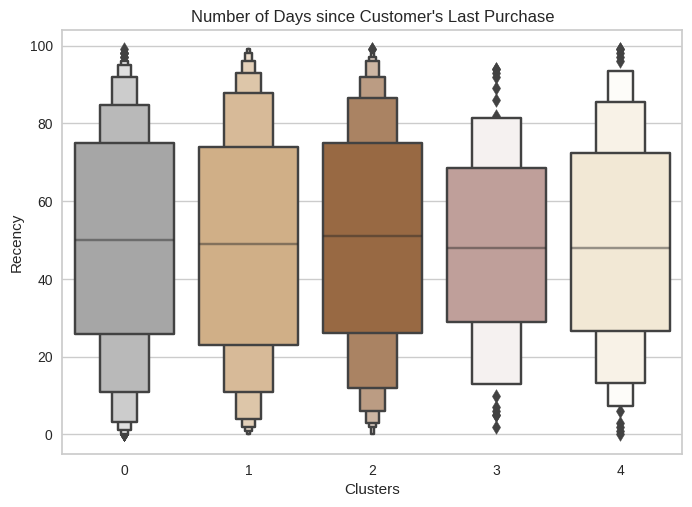

In [ ]:
#Plotting the number of days since the customer's last purchase
plt.figure()
pl=sns.boxenplot(y=concat_df["Recency"],x=concat_df['Cluster_Customer'], palette= pal)
pl.set_title("Number of Days since Customer's Last Purchase")
pl.set_xlabel("Clusters")
plt.show()

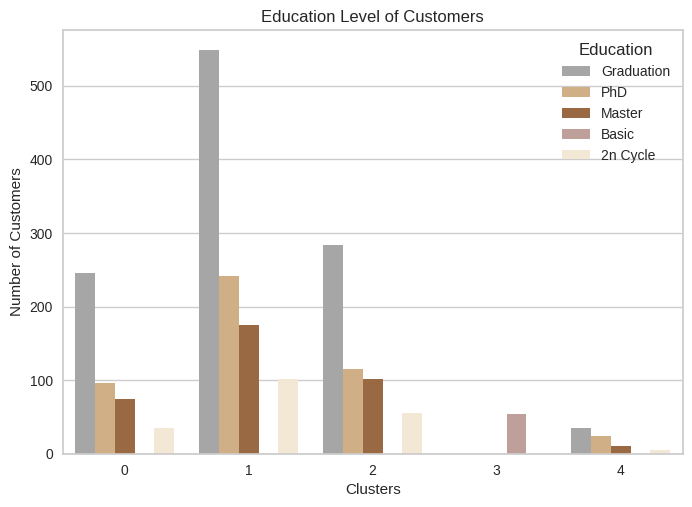

In [ ]:
#Plotting education level of customers in each cluster
plt.figure()
pl = sns.countplot(x=concat_df['Cluster_Customer'],hue=concat_df["Education"], palette= pal)
pl.set_title("Education Level of Customers")
pl.set_xlabel("Clusters")
pl.set_ylabel("Number of Customers")
plt.show()

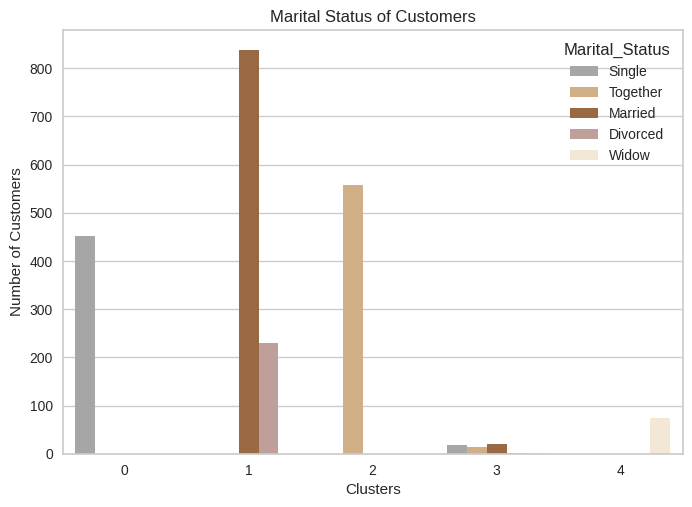

In [ ]:
#Plotting marital status of customers in each cluster
plt.figure()
pl = sns.countplot(x=concat_df['Cluster_Customer'],hue=concat_df["Marital_Status"], palette= pal)
pl.set_title("Marital Status of Customers")
pl.set_xlabel("Clusters")
pl.set_ylabel("Number of Customers")
plt.show()

Customer purchasing habit and preference

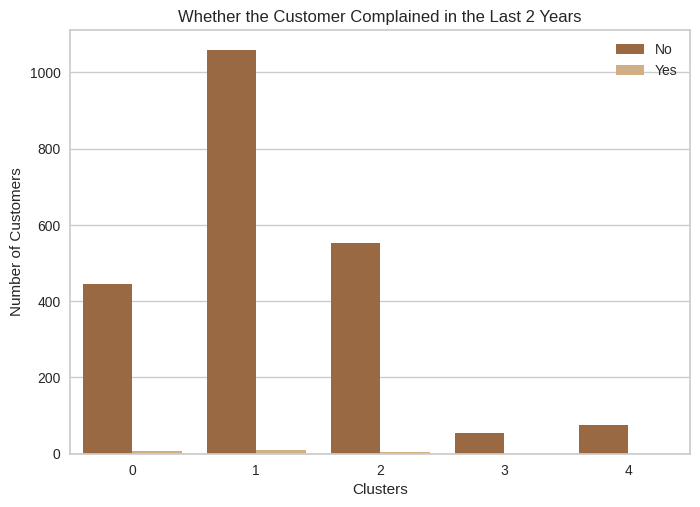

In [ ]:
#Plotting whether the customer complained in the last 2 years
plt.figure()
pl = sns.countplot(x=concat_df['Cluster_Customer'],hue=concat_df["Complain"], palette= ["#A66735","#dcb07b"])
pl.set_title("Whether the Customer Complained in the Last 2 Years")
pl.set_xlabel("Clusters")
pl.set_ylabel("Number of Customers")
legend = plt.legend()
for t, label in zip(legend.texts, ['No', 'Yes']):
    t.set_text(label)
plt.show()

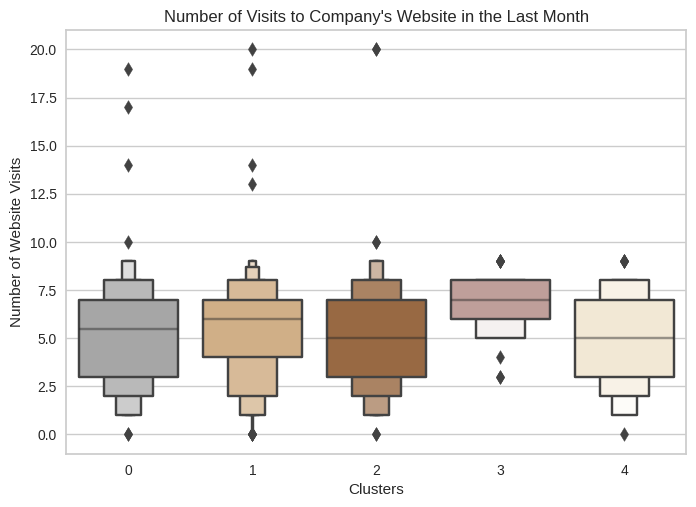

In [ ]:
#Plotting number of visits to company’s website in the last month
plt.figure()
pl=sns.boxenplot(y=concat_df["NumWebVisitsMonth"],x=concat_df['Cluster_Customer'], palette= pal)
pl.set_title("Number of Visits to Company's Website in the Last Month")
pl.set_xlabel("Clusters")
pl.set_ylabel("Number of Website Visits")
plt.show()

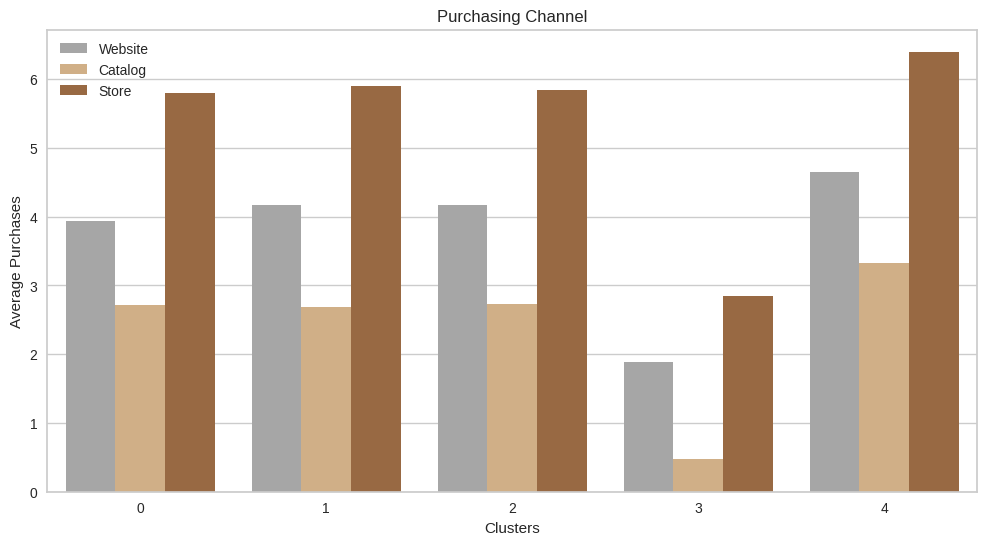

In [ ]:
df3 = concat_df.copy()
cluster_means = df3.groupby('Cluster_Customer')[['NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases']].mean().reset_index()

cluster_means_melted = pd.melt(cluster_means, id_vars='Cluster_Customer', var_name='PurchaseType', value_name='AveragePurchases')

plt.figure(figsize=(12, 6))
sns.barplot(x='Cluster_Customer', y='AveragePurchases', hue='PurchaseType', data=cluster_means_melted, palette= pal)

plt.title('Purchasing Channel')
plt.xlabel('Clusters')
plt.ylabel('Average Purchases')

legend = plt.legend()
for t, label in zip(legend.texts, ['Website', 'Catalog', 'Store']):
    t.set_text(label)

plt.show()

In [ ]:
products = ['MntWines', 'MntFruits','MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds']
clusters = [cluster0, cluster1, cluster2, cluster3, cluster4]
scaler = StandardScaler()
i = 0
for cluster in clusters:
  # max_product = cluster[products].max().idxmax()
  avg = {}
  cluster_copy = cluster.copy()
  cluster_copy[products] = scaler.fit_transform(cluster_copy[products])
  for product in products:
    avg_product = cluster_copy[product].mean()
    avg[product] = avg_product
  max_product = max(avg.values())
  print(f"Cluster {i} :")
  print(avg)
  print("Max product for this cluster is:", max_product)
  i = i + 1
# cluster0['max_product'].describe() #Gold
# cluster1['max_product'].describe() #Meat
# cluster2['max_product'].describe() #Fruits
# cluster3['max_product'].describe() #Fruits
# cluster4['max_product'].describe() #Fruits

Cluster 0 :
{'MntWines': 1.964996503761339e-17, 'MntFruits': 2.3579958045136068e-17, 'MntMeatProducts': -2.7509951052658746e-17, 'MntFishProducts': -7.859986015045356e-18, 'MntSweetProducts': 3.929993007522678e-18, 'MntGoldProds': 3.1439944060181424e-17}
Max product for this cluster is: 3.1439944060181424e-17
Cluster 1 :
{'MntWines': -1.2902310689177077e-17, 'MntFruits': 1.6648142824744616e-18, 'MntMeatProducts': 5.327405703918277e-17, 'MntFishProducts': -1.3318514259795693e-17, 'MntSweetProducts': -1.6648142824744616e-18, 'MntGoldProds': -7.158701414640184e-17}
Max product for this cluster is: 5.327405703918277e-17
Cluster 2 :
{'MntWines': 1.913490311741742e-17, 'MntFruits': 3.18915051956957e-17, 'MntMeatProducts': -5.740470935225226e-17, 'MntFishProducts': 1.594575259784785e-18, 'MntSweetProducts': -2.232405363698699e-17, 'MntGoldProds': -6.37830103913914e-18}
Max product for this cluster is: 3.18915051956957e-17
Cluster 3 :
{'MntWines': 2.2615654205327262e-17, 'MntFruits': 3.7007434

# Object 2: Product Purchase Prediction

In [ ]:
df2 = concat_df.copy()
df2

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,age,Education_Basic,Education_Graduation,Education_Master,Education_PhD,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Cluster_Customer
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,57,0,1,0,0,0,1,0,0,0
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,60,0,1,0,0,0,1,0,0,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,49,0,1,0,0,0,0,1,0,2
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,30,0,1,0,0,0,0,1,0,2
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,33,0,0,0,1,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,13-06-2013,46,709,...,47,0,1,0,0,1,0,0,0,1
2236,4001,1946,PhD,Together,64014.0,2,1,10-06-2014,56,406,...,68,0,0,0,1,0,0,1,0,2
2237,7270,1981,Graduation,Divorced,56981.0,0,0,25-01-2014,91,908,...,33,0,1,0,0,0,0,0,0,1
2238,8235,1956,Master,Together,69245.0,0,1,24-01-2014,8,428,...,58,0,0,1,0,0,0,1,0,2


In [ ]:
products = ['MntWines', 'MntFruits','MntMeatProducts', 'MntFishProducts',
            'MntSweetProducts', 'MntGoldProds']
percentiles = df[products].quantile([0, 0.25, 0.5, 0.75, 1])
def map_percentile(value, percentiles):
    if value <= percentiles.iloc[0]:
        return 0
    elif value <= percentiles.iloc[1]:
        return 1
    elif value <= percentiles.iloc[2]:
        return 2
    elif value <= percentiles.iloc[3]:
        return 3
    else:
        return 4

for column in products:
  name = column + '_per'
  df2[name] = df2[column].apply(lambda x: map_percentile(x, percentiles[column]))

for column in products:
    name = column + '_per'
    df2[name] = df2[column].apply(lambda x: map_percentile(x, percentiles[column]))
    class_distribution = df2[name].value_counts().sort_index()
    print(class_distribution)

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Cluster_Customer,MntWines_per,MntFruits_per,MntMeatProducts_per,MntFishProducts_per,MntSweetProducts_per,MntGoldProds_per
count,551.000000,551.000000,551.000000,551.000000,551.000000,551.000000,551.000000,551.000000,551.000000,551.000000,...,551.000000,551.000000,551.000000,551.000000,551.000000,551.000000,551.0,551.000000,551.000000,551.000000
mean,5661.103448,1968.081670,75246.417423,0.063521,0.261343,49.548094,624.023593,63.172414,493.892922,92.185118,...,0.234120,0.261343,0.039927,1.147005,3.531760,3.435572,4.0,3.502722,3.470054,3.212341
std,3189.663397,13.029709,11982.681612,0.244119,0.471683,29.445866,322.877108,48.884662,219.712782,65.205342,...,0.423832,0.439766,0.195967,0.913627,0.601807,0.999512,0.0,0.932003,1.006575,0.989174
min,0.000000,1941.000000,2447.000000,0.000000,0.000000,0.000000,1.000000,0.000000,234.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.0,0.000000,0.000000,0.000000
25%,2985.000000,1957.000000,68688.500000,0.000000,0.000000,24.000000,376.500000,24.000000,323.000000,40.000000,...,0.000000,0.000000,0.000000,1.000000,3.000000,3.000000,4.0,3.000000,3.000000,3.000000
50%,5547.000000,1969.000000,75433.000000,0.000000,0.000000,51.000000,565.000000,51.000000,431.000000,80.000000,...,0.000000,0.000000,0.000000,1.000000,4.000000,4.000000,4.0,4.000000,4.000000,3.000000
75%,8498.000000,1978.000000,81615.500000,0.000000,0.000000,74.000000,852.000000,93.000000,611.500000,137.000000,...,0.000000,1.000000,0.000000,2.000000,4.000000,4.000000,4.0,4.000000,4.000000,4.000000
max,11112.000000,1995.000000,160803.000000,1.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,258.000000,...,1.000000,1.000000,1.000000,4.000000,4.000000,4.000000,4.0,4.000000,4.000000,4.000000


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.metrics import r2_score


X = df2[['age', 'Income', 'children', 'Education_Basic', 'Education_Graduation', 'Education_Master',
        'Education_PhD', 'Marital_Status_Married', 'Marital_Status_Single',
        'Marital_Status_Together', 'Marital_Status_Widow', 'NumWebPurchases',
        'NumCatalogPurchases', 'NumStorePurchases']]

y = df2[['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response']]

features = ['age','Income','children','Education_Basic', 'Education_Graduation', 'Education_Master',
       'Education_PhD', 'Marital_Status_Married', 'Marital_Status_Single',
       'Marital_Status_Together', 'Marital_Status_Widow','NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases','Recency','NumDealsPurchases'] #2

# features = ['age','Income','children','Education_Basic', 'Education_Graduation', 'Education_Master',
#        'Education_PhD', 'Marital_Status_Married', 'Marital_Status_Single',
#        'Marital_Status_Together', 'Marital_Status_Widow','NumWebPurchases',
#        'NumCatalogPurchases', 'NumStorePurchases', 'Recency', 'NumDealsPurchases',
#        'AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response'] #1

# features = ['age','Income','children', 'NumWebPurchases',
#        'NumCatalogPurchases', 'NumStorePurchases','Recency','NumDealsPurchases'] #3

targets = ['MntWines_per', 'MntFruits_per','MntMeatProducts_per', 'MntFishProducts_per', 'MntSweetProducts_per', 'MntGoldProds_per']

X_train, X_test, y_train, y_test = train_test_split(df2[features], df2[targets], test_size=0.2, random_state=42)

models = {}
importance={}
for target in targets:
    model = RandomForestClassifier(random_state=42)
    model.fit(X_train, y_train[target])
    models[target] = model
    feature = model.feature_importances_
    feature_importance = pd.DataFrame(feature, index=features, columns=["Importance"])
    feature_importance.sort_values(by="Importance", ascending=False, inplace=True)
    importance[target]=feature_importance
    print(feature_importance)

    plt.figure(figsize=(12, 8))
    plt.bar(feature_importance.index, feature_importance['Importance'], color='skyblue')
    plt.title(f'Feature Importance for {target}', fontsize=16)
    plt.xlabel('Features', fontsize=14)
    plt.ylabel('Importance', fontsize=14)
    plt.xticks(rotation=45, ha='right', fontsize=12)
    plt.yticks(fontsize=12)
    plt.tight_layout()
    plt.grid(True, axis='y', linestyle='--', alpha=0.7)
    plt.show()

predictions = {target: models[target].predict(X_test) for target in targets}
for target in targets:
    r2=r2_score(y_test[target], predictions[target])
    print(f'R-squared for {target}: {r2}')
    acc = accuracy_score(y_test[target], predictions[target])
    print(f'Accuracy for {target}: {acc}')
    cm = confusion_matrix(y_test[target], predictions[target])
    print(f'Confusion Matrix for {target}:\n {cm}')
    print("Classification Report:\n", classification_report(y_test[target], predictions[target]))

Accuracy for MntWines_per: 0.7278911564625851
Confusion Matrix for MntWines_per:
 [[ 0  5  0  0  0]
 [ 0 90  9  0  0]
 [ 0 18 77 11  6]
 [ 0  0 13 70 29]
 [ 0  0  0 29 84]]
Accuracy for MntFruits_per: 0.5374149659863946
Confusion Matrix for MntFruits_per:
 [[35 15 17 10  7]
 [14 20 15  5  0]
 [11  5 46 12  4]
 [ 6  2 22 56 32]
 [ 2  0  3 22 80]]
Accuracy for MntMeatProducts_per: 0.7301587301587301
Confusion Matrix for MntMeatProducts_per:
 [[89 22  0  0]
 [20 65 23  0]
 [ 0 11 80 26]
 [ 0  0 17 88]]
Accuracy for MntFishProducts_per: 0.5102040816326531
Confusion Matrix for MntFishProducts_per:
 [[27 17 16 12  9]
 [18 22 15  4  0]
 [ 5 10 49 20  6]
 [ 4  2 22 43 36]
 [ 0  0  3 17 84]]
Accuracy for MntSweetProducts_per: 0.5668934240362812
Confusion Matrix for MntSweetProducts_per:
 [[38  3 24 10 10]
 [13  9 12  4  0]
 [14  4 57 11  3]
 [ 6  0 19 61 36]
 [ 1  0  1 20 85]]
Accuracy for MntGoldProds_per: 0.5668934240362812
Confusion Matrix for MntGoldProds_per:
 [[ 2  5  1  1  1]
 [ 1 73 19 

In [ ]:
from sklearn.model_selection import cross_val_score
for target in targets:
    scores = cross_val_score(models[target], df2[features], df2[targets][target], cv=5)
#     print(f"Cross-validated scores for {target}: {scores}")
    print(f"Mean score for {target}: {scores.mean()}")


In [ ]:
import statsmodels.api as sm
from sklearn.linear_model import LogisticRegression
from statsmodels.discrete.discrete_model import MNLogit

# X_train = X_train.values
# X_test = X_test.values
models={}
for target in targets:
    # X_train = sm.add_constant(X_train)
    logit_model = LogisticRegression(multi_class='multinomial', solver='lbfgs')
    model = sm.MNLogit(y_train[target], X_train)
    result = model.fit()
    models[target]=result
    print(result.summary())
    # coefficients = logit_model.coef_
    # feature_names = X_train.columns
    # coef_df = pd.DataFrame(coefficients, columns=feature_names)
    # print(coef_df)

# predictions={}
# predictions = {target: models[target].predict(X_test) for target in targets}
# for target in targets:
    # print("\nClassification Report:")
    # print(classification_report(y_test[target], predictions[target]))
    # acc = accuracy_score(y_test[target], predictions[target])
    # print(f'Accuracy for {target}: {acc}')
    # cm = confusion_matrix(y_test[target], predictions[target])
    # print(f'Confusion Matrix for {target}:\n {cm}')
    # print(classification_report(y_test[target], predictions[target]))

         Current function value: 0.810075
         Iterations: 35
                          MNLogit Regression Results                          
Dep. Variable:           MntWines_per   No. Observations:                 1764
Model:                        MNLogit   Df Residuals:                     1708
Method:                           MLE   Df Model:                           52
Date:                Sat, 02 Dec 2023   Pseudo R-squ.:                  0.4250
Time:                        08:44:54   Log-Likelihood:                -1429.0
converged:                      False   LL-Null:                       -2485.3
Covariance Type:            nonrobust   LLR p-value:                     0.000
         MntWines_per=1       coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
age                        -0.0177      0.041     -0.429      0.668      -0.099       0.063
Income                   6

In [ ]:
from sklearn.tree import DecisionTreeClassifier
for target in targets:
  decision_tree_model = DecisionTreeClassifier(random_state=42)
  decision_tree_model.fit(X_train, y_train[target])
  y_pred = decision_tree_model.predict(X_test)
  print(classification_report(y_test[target], y_pred))
  acc = accuracy_score(y_test[target], y_pred)
  print(f'Accuracy for {target}: {acc}')
  plt.figure(figsize=(60, 30), dpi=400)
  print(target)
  tree.plot_tree(decision_tree_model)

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         5
           1       0.77      0.86      0.81        99
           2       0.64      0.64      0.64       112
           3       0.60      0.51      0.55       112
           4       0.66      0.71      0.68       113

    accuracy                           0.67       441
   macro avg       0.53      0.54      0.54       441
weighted avg       0.66      0.67      0.66       441

Accuracy for MntWines_per: 0.6666666666666666
MntWines_per
              precision    recall  f1-score   support

           0       0.34      0.37      0.36        84
           1       0.39      0.41      0.40        54
           2       0.41      0.41      0.41        78
           3       0.44      0.47      0.45       118
           4       0.60      0.51      0.55       107

    accuracy                           0.44       441
   macro avg       0.44      0.43      0.43       441
weighted avg      

# Object 3: Promotion Campaign

In [ ]:
X = df2[['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response']]
X['SumColumn'] = X.sum(axis=1)
X['SumColumn'].describe()

count_equal_to_1 = (X['SumColumn'] == 1).sum()
count_equal_to_2 = (X['SumColumn'] == 2).sum()
count_equal_to_3 = (X['SumColumn'] == 3).sum()
count_equal_to_4 = (X['SumColumn'] == 4).sum()
count_equal_to_5 = (X['SumColumn'] == 5).sum()
count_equal_to_6 = (X['SumColumn'] == 6).sum()
print(f"Number of customers accept 1 offer in all campaigns: {count_equal_to_1}")
print(f"Number of customers accept 2 offers in all campaigns: {count_equal_to_2}")
print(f"Number of customers accept 3 offers in all campaigns: {count_equal_to_3}")
print(f"Number of customers accept 4 offers in all campaigns: {count_equal_to_4}")
print(f"Number of customers accept 5 offers in all campaigns: {count_equal_to_5}")
print(f"Number of customers accept 6 offers in all campaigns: {count_equal_to_6}")
print((X['SumColumn'] >= 5).sum() / len(X))

Number of customers accept 1 offer in all campaigns: 367
Number of customers accept 2 offers in all campaigns: 138
Number of customers accept 3 offers in all campaigns: 50
Number of customers accept 4 offers in all campaigns: 36
Number of customers accept 5 offers in all campaigns: 10
Number of customers accept 6 offers in all campaigns: 0
0.0045351473922902496


In [ ]:
X = df2[['age', 'Income', 'children', 'Education_Basic', 'Education_Graduation', 'Education_Master',
        'Education_PhD', 'Marital_Status_Married', 'Marital_Status_Single',
        'Marital_Status_Together', 'Marital_Status_Widow', 'NumWebPurchases',
        'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth']]
y = df2[['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response']]

X = sm.add_constant(X)

for col in y.columns:
    print(f"Logistic Regression for {col}:")

    model = sm.Logit(y[col], X)
    result = model.fit()

    print(result.summary())
    print("\n" + "="*80 + "\n")

Logistic Regression for AcceptedCmp1:
         Current function value: 0.166877
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:           AcceptedCmp1   No. Observations:                 2205
Model:                          Logit   Df Residuals:                     2189
Method:                           MLE   Df Model:                           15
Date:                Sat, 02 Dec 2023   Pseudo R-squ.:                  0.2979
Time:                        08:41:53   Log-Likelihood:                -367.96
converged:                      False   LL-Null:                       -524.10
Covariance Type:            nonrobust   LLR p-value:                 1.563e-57
                              coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                      -8.3099      0.974     -8.531      0.000     -10.219 

In [ ]:
X = df2[['age', 'Income', 'children', 'Education_Basic', 'Education_Graduation', 'Education_Master',
        'Education_PhD', 'Marital_Status_Married', 'Marital_Status_Single',
        'Marital_Status_Together', 'Marital_Status_Widow', 'NumWebPurchases',
        'NumCatalogPurchases', 'NumStorePurchases']]
y = df2[['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response']]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = MultiOutputClassifier(LogisticRegression())
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test.values.flatten(), y_pred.flatten())
classification_rep = classification_report(y_test, y_pred)


print(f"Accuracy: {accuracy}")
print(f"Confusion Matrix:\n{conf_matrix}")
print(f"Classification Report:\n{classification_rep}")
# count_of_ones = np.sum(y == 1)
# print(count_of_ones)
y_test

Accuracy: 0.7165532879818595
Confusion Matrix:
[[2433   11]
 [ 196    6]]
Classification Report:
              precision    recall  f1-score   support

           0       0.33      0.07      0.11        30
           1       0.00      0.00      0.00         4
           2       0.00      0.00      0.00        40
           3       0.00      0.00      0.00        30
           4       0.40      0.13      0.20        31
           5       0.00      0.00      0.00        67

   micro avg       0.35      0.03      0.05       202
   macro avg       0.12      0.03      0.05       202
weighted avg       0.11      0.03      0.05       202
 samples avg       0.01      0.00      0.01       202



,AcceptedCmp1,AcceptedCmp2,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,Response
1989,0,0,0,0,0,0
1110,0,0,0,0,0,0
1491,0,0,0,0,0,0
457,0,0,1,0,0,1
1813,1,0,0,0,0,0
...,...,...,...,...,...,...
1333,0,0,0,0,0,0
949,0,0,0,0,0,0
1758,0,0,0,0,0,0
64,0,0,0,0,0,0


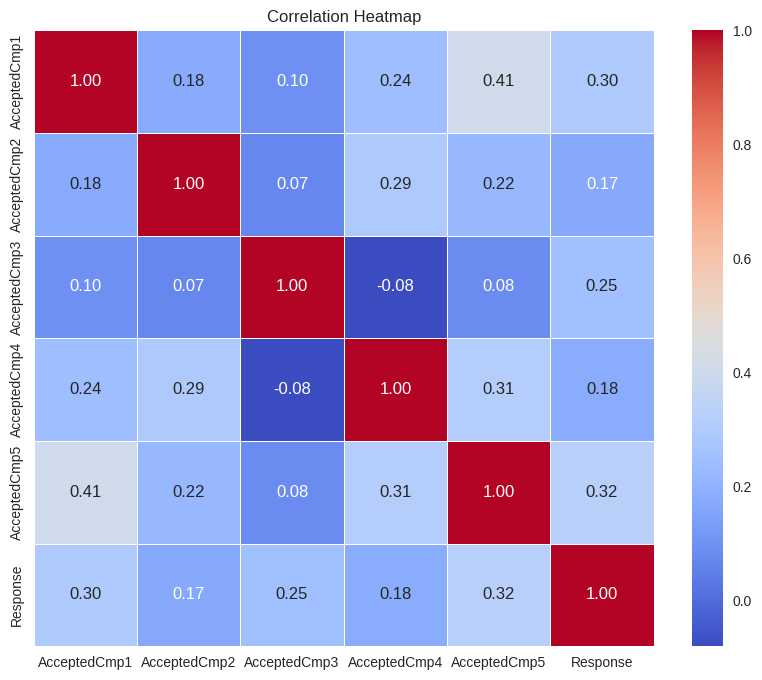

In [ ]:
subset_df = df2[['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response']]
correlation_matrix = subset_df.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

In [ ]:
X_columns = ['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5']
y = df2['NumDealsPurchases']
df2['Cmp1&Cmp5'] = df2['AcceptedCmp1'] * df2['AcceptedCmp5']
X = sm.add_constant(df2[X_columns + ['Cmp1&Cmp5']])


print(f"OLS Regression for NumDealsPurchases:")
model = sm.OLS(y, X)
result = model.fit()
print(result.summary())

OLS Regression for NumDealsPurchases:
                            OLS Regression Results                            
Dep. Variable:      NumDealsPurchases   R-squared:                       0.044
Model:                            OLS   Adj. R-squared:                  0.042
Method:                 Least Squares   F-statistic:                     17.06
Date:                Sat, 02 Dec 2023   Prob (F-statistic):           2.36e-19
Time:                        08:41:54   Log-Likelihood:                -4521.5
No. Observations:                2205   AIC:                             9057.
Df Residuals:                    2198   BIC:                             9097.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const     

In [ ]:
X = df2[['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response']]
y = df2['NumDealsPurchases']
X = sm.add_constant(X)

print(f"OLS Regression for NumDealsPurchases without Interaction Term:")
model = sm.OLS(y, X)
result = model.fit()
print(result.summary())

OLS Regression for NumDealsPurchases without Interaction Term:
                            OLS Regression Results                            
Dep. Variable:      NumDealsPurchases   R-squared:                       0.050
Model:                            OLS   Adj. R-squared:                  0.047
Method:                 Least Squares   F-statistic:                     19.24
Date:                Sat, 02 Dec 2023   Prob (F-statistic):           5.76e-22
Time:                        08:41:54   Log-Likelihood:                -4515.3
No. Observations:                2205   AIC:                             9045.
Df Residuals:                    2198   BIC:                             9084.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------